In [1]:
# Importing the libraries
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

import glob
import os
import warnings

from astropy.io import fits
from astropy.nddata import CCDData
from astropy.stats import sigma_clipped_stats
from astropy.utils.exceptions import AstropyWarning
from astropy.visualization import MinMaxInterval, AsinhStretch, ImageNormalize

from photutils.detection import DAOStarFinder
from photutils.aperture import CircularAperture, aperture_photometry

In [2]:
# Plot settings 
plt.rc('font', size=10)
plt.rcParams['font.family'] = 'Liberation Serif'

In [3]:
# Warnings
warnings.simplefilter('ignore', AstropyWarning)

In [4]:
# Used filters
filters = ['B', 'V', 'R']

In [5]:
def create_master_frame(master_type='bias', filter=None):
    # Load all files and stack them
    os.makedirs('master', exist_ok=True)
    if 'flat' in master_type:
        print(f'Creating master {master_type} for {filter} filter...')
        file_list = glob.glob(f'data/{master_type}/{filter}/*.fits')
    else:
        print(f'Creating master {master_type}...')
        file_list = glob.glob(f'data/{master_type}/*.fits')

    image_stack = [CCDData.read(file, unit='adu') for file in file_list]

    # Combine images by averaging
    if master_type == 'bias':
        master_frame = np.mean([image.data for image in image_stack], axis=0)
        master_filename = f'master/{master_type}.fits'
        fits.writeto(master_filename, master_frame, overwrite=True)
    elif master_type == 'dark':
        master_frame = np.median([image.data for image in image_stack], axis=0)
        master_filename = f'master/{master_type}.fits'
        fits.writeto(master_filename, master_frame, overwrite=True)
    elif master_type == 'flat':
        master_frame = np.mean([image.data for image in image_stack], axis=0)
        master_filename = f'master/{master_type}_{filter}.fits'
        fits.writeto(master_filename, master_frame, overwrite=True)

    return master_frame,

def apply_calibration(object_name, master_bias, master_dark, master_flats, filter='B'):
    print(f'Calibrating images for {filter} filter...')
    # Read the observation file
    fits_files = glob.glob(f'{object_name}/original/{filter}/*.fits')
    for fits_file in fits_files:
        with fits.open(fits_file) as hdul:
            obs_data = hdul[0].data
            header = hdul[0].header
            
            # Calibrate the data
            calibrated_data = ((obs_data - master_bias - master_dark) / master_flats[filter]) * np.median(master_flats[filter])
            
            # Update header to indicate processing
            header['HISTORY'] = 'Calibrated using custom script with master frames'
            
            # Write the calibrated data to a new FITS file
            os.makedirs(f'{object_name}/calibrated/{filter}', exist_ok=True)
            calibrated_filename = f"{object_name}/calibrated/{filter}/{os.path.splitext(os.path.basename(fits_file))[0]}_calibrated.fits"
            fits.writeto(calibrated_filename, calibrated_data, header, overwrite=True)

            # Closing the file
            hdul.close()

def stack_fits(object_name, filter='B'):
    # Load fits files
    fits_files = glob.glob(f'{object_name}/aligned/{filter}/*.fits')

    # Calculate total exposure time
    total_exposure_time = 0
    for fits_file in fits_files:
        with fits.open(fits_file) as hdul:
            header = hdul[0].header
            total_exposure_time += header['EXPTIME']

    # Stack using mean
    image_stack = [CCDData.read(file, unit='adu') for file in fits_files]
    combined_image = np.mean(image_stack, axis=0)
    
    # Save stacked image
    os.makedirs(f'{object_name}/stacked', exist_ok=True)
    output_file = f'{object_name}/stacked/{filter}_stacked.fits'
    
    fits.writeto(output_file, combined_image, overwrite=True)

    return combined_image, total_exposure_time

def find_stars(image, threshold, fwhm):
    mean, median, std = sigma_clipped_stats(image, sigma=3.0)
    daofind = DAOStarFinder(fwhm=fwhm, threshold=threshold * std)
    sources = daofind(image - median)
    return sources

# Function to match stars based on position
def match_stars(coords1, coords2, coords3, tolerance):
    matched_stars = []
    for i, (x1, y1) in enumerate(coords1):
        for j, (x2, y2) in enumerate(coords2):
            for k, (x3, y3) in enumerate(coords3):
                if (np.sqrt((x1 - x2) ** 2 + (y1 - y2) ** 2) < tolerance and
                    np.sqrt((x1 - x3) ** 2 + (y1 - y3) ** 2) < tolerance):
                    matched_stars.append((x1, y1, i, j, k))
    return matched_stars

def colour_images(object_name, stacked_images, a, b, shift_x, shift_y, x_min_bkg, y_min_bkg, width_bkg, height_bkg, radius_ws, threshold):
    # Loading images B, V, R
    bvr_images = [stacked_images[filter] for filter in filters]

    # Cutting the region we need from images
    center_x, center_y = bvr_images[0].shape[1] // 2, bvr_images[0].shape[0] // 2

    x1, x2 = center_x + shift_x - a // 2, center_x + shift_x  + a // 2
    y1, y2 = center_y + shift_y  - b // 2, center_y + shift_y + b // 2

    bvr_cut = [img[y1:y2, x1:x2] for img in bvr_images]

    # Subtracting background 
    # x_max_bkg = x_min_bkg + width_bkg
    # y_max_bkg = y_min_bkg + height_bkg

    # bkg = np.zeros(3)
    # bkg[0] = np.median(bvr_cut[0][y_min_bkg:y_max_bkg, x_min_bkg:x_max_bkg])  
    # bkg[1] = np.median(bvr_cut[1][y_min_bkg:y_max_bkg, x_min_bkg:x_max_bkg])
    # bkg[2] = np.median(bvr_cut[2][y_min_bkg:y_max_bkg, x_min_bkg:x_max_bkg])

    # print(f"Background values: {bkg}")

    # bvr_cut = [img - b for img, b in zip(bvr_cut, bkg)]

    # Normalize images from 0 to 1
    for i in range(3):
        bvr_cut[i] = (bvr_cut[i] - np.min(bvr_cut[i])) / (np.max(bvr_cut[i]) - np.min(bvr_cut[i]))

    # Converting BVR to XYZ
    xyz_images = np.zeros_like(bvr_cut)

    xyz_images[0] = 0.19362 * bvr_cut[0] + 0.59315 * bvr_cut[1] + 0.31060 * bvr_cut[2]  # X
    xyz_images[1] = 0.08265 * bvr_cut[0] + 1.10069 * bvr_cut[1] + 0.08009 * bvr_cut[2]  # Y
    xyz_images[2] = 1.38826 * bvr_cut[0] - 0.11459 * bvr_cut[1] + 0.01970 * bvr_cut[2]  # Z

    # Normalize images from 0 to 1
    for i in range(3):
        xyz_images[i] = (xyz_images[i] - xyz_images[i].min()) / (xyz_images[i].max() - xyz_images[i].min())

    # White spot correction
    # Define parameters
    fwhm = 3.0  # Approximate FWHM of stars
    tolerance = 10.0  # Max pixel offset for matching stars

    B, V, R = bvr_cut

    sources_B = find_stars(B, threshold, fwhm)
    sources_V = find_stars(V, threshold, fwhm)
    sources_R = find_stars(R, threshold, fwhm)

    # Convert to NumPy arrays
    coords_B = np.array([sources_B['xcentroid'], sources_B['ycentroid']]).T
    coords_V = np.array([sources_V['xcentroid'], sources_V['ycentroid']]).T
    coords_R = np.array([sources_R['xcentroid'], sources_R['ycentroid']]).T

    matched_stars = match_stars(coords_B, coords_V, coords_R, tolerance)

    # Compute B-V for matched stars
    b_v_values = []
    star_positions = []

    for x, y, i, j, k in matched_stars:
        # Extract flux values from the detected stars
        flux_B = B[int(y), int(x)]
        flux_V = V[int(y), int(x)]
        
        # Compute instrumental magnitudes
        mag_B = -2.5 * np.log10(flux_B)
        mag_V = -2.5 * np.log10(flux_V)
        
        # Compute B-V index
        b_v = mag_B - mag_V
        b_v_values.append(b_v)
        star_positions.append((x, y))

    # Find the star with the B-V closest to zero
    if b_v_values:
        closest_star_idx = np.argmin(np.abs(np.array(b_v_values)))
        closest_star_position = star_positions[closest_star_idx]
        closest_bv_value = b_v_values[closest_star_idx]
        print(f"Closest star with B-V index {closest_bv_value:.2f}")
    else:
        print("No matched stars found.")

    # Create a grid of coordinates
    y, x = np.ogrid[:xyz_images[1].shape[0], :xyz_images[1].shape[1]]

    # Compute the distance of each pixel from the star center
    distance_from_star = np.sqrt((x - closest_star_position[0])**2 + (y - closest_star_position[1])**2)

    # Create a mask for pixels within the circular region
    circular_mask = distance_from_star <= radius_ws

    white_spot_Y = np.median(xyz_images[1][circular_mask])

    scale_X = 0.9505 / (xyz_images[0][circular_mask] / white_spot_Y).mean()
    scale_Z = 1.0890 / (xyz_images[2][circular_mask] / white_spot_Y).mean()

    xyz_images[0] = xyz_images[0] * scale_X
    xyz_images[2] = xyz_images[2] * scale_Z

    # Normalize images from 0 to 1
    for i in range(3):
        xyz_images[i] = (xyz_images[i] - xyz_images[i].min()) / (xyz_images[i].max() - xyz_images[i].min())

    # Converting XYZ to RGB
    rgb_images = np.zeros_like(xyz_images)

    rgb_images[0] = 3.2410 * xyz_images[0] - 1.5374 * xyz_images[1] - 0.4986 * xyz_images[2]  # R
    rgb_images[1] = -0.9692 * xyz_images[ 0] + 1.8760 * xyz_images[1] + 0.0416 * xyz_images[2]  # G
    rgb_images[2] = 0.0556 * xyz_images[0] - 0.2040 * xyz_images[1] + 1.0570 * xyz_images[2]  # B

    # Normalize images from 0 to 1
    for i in range(3):
        rgb_images[i] = (rgb_images[i] - rgb_images[i].min()) / (rgb_images[i].max() - rgb_images[i].min())

    # Gamma correction
    srgb_images = np.where(rgb_images <= 0.0031308,
                            12.92 * rgb_images,
                            1.055 * (rgb_images ** (1 / 2.4)) - 0.055)

    # Save BVR images
    for i, filter in enumerate(filters):
        os.makedirs(f'{object_name}/image_fits/BVR', exist_ok=True)
        fits.writeto(f'{object_name}/image_fits/BVR/{filter}.fits', bvr_cut[i], overwrite=True)

    # Save XYZ images
    for i, channel in enumerate(['X', 'Y', 'Z']):
        os.makedirs(f'{object_name}/image_fits/XYZ', exist_ok=True)
        fits.writeto(f'{object_name}/image_fits/XYZ/{channel}.fits', xyz_images[i], overwrite=True)

    # Save sRGB images
    for i, channel in enumerate(['R', 'G', 'B']):
        os.makedirs(f'{object_name}/image_fits/sRGB', exist_ok=True)
        fits.writeto(f'{object_name}/image_fits/sRGB/{channel}.fits', srgb_images[i], overwrite=True)

    # Normalize each channel separately using percentiles
    def normalize_channels(channels):
        normalized_channels = []
        for channel in channels:
            vmin, vmax = np.percentile(channel, (0.5, 99.5))  # Compute separately
            normalized = np.clip((channel - vmin) / (vmax - vmin), 0, 1)  # Normalize
            normalized_channels.append(normalized)
        return normalized_channels
    
    bvr_cut = normalize_channels(bvr_cut)
    xyz_images = normalize_channels(xyz_images)
    srgb_images = normalize_channels(srgb_images)

    # Combine images
    combined_bvr = np.stack([bvr_cut[0], bvr_cut[1], bvr_cut[2]], axis=-1)
    combined_xyz = np.stack([xyz_images[0], xyz_images[1], xyz_images[2]], axis=-1)
    combined_srgb = np.stack([srgb_images[0], srgb_images[1], srgb_images[2]], axis=-1)

    # Inverting colors
    # combined_bvr = 1 - combined_bvr
    # combined_xyz = 1 - combined_xyz
    # combined_srgb = 1 - combined_srgb

    # Creating images folder

    os.makedirs(f'images/{object_name}', exist_ok=True)

    # Plotting original BVR images
    fig, axes = plt.subplots(3, 1, figsize=(10, 30))
    for i, ax in enumerate(axes):
        vmin, vmax = np.percentile(bvr_cut[i], (0.5, 99.5))

        ax.set_title(f'{filters[i]}', fontsize=25)
        
        ax.axis('off')
        
        ax.imshow(bvr_cut[i], cmap='gray', origin='lower', vmin=vmin, vmax=vmax)

        # rect = plt.Rectangle((x_min_bkg, y_min_bkg), width_bkg, height_bkg, linewidth=1, edgecolor='r', facecolor='none', label='Background')
        # ax.add_patch(rect)

        circle = plt.Circle(closest_star_position, radius_ws, color='r', fill=False, label='White spot')
        ax.add_patch(circle)

        # Checking white spot star
        # for x, y, i, j, k in matched_stars:
        #     aperture = CircularAperture((x, y), r=5)
        #     aperture.plot(color='red', lw=1.5, alpha=0.5, ax=ax)

        # if b_v_values:
        #     ax.scatter(closest_star_position[0], closest_star_position[1], color='red', marker='o', s=20, label=f"B-V: {closest_bv_value:.2f}")
        #     ax.legend(fontsize=15)

        ax.set_ylim(ax.get_ylim()[::-1]) 
        ax.set_xlim(ax.get_xlim()[::-1])
        
    plt.tight_layout()
    plt.savefig(f'images/{object_name}/{object_name}_ind.png')
    plt.show()

    # Plotting combined BVR, XYZ and sRGB images
    colour_systems_names = ['BVR', 'XYZ', 'sRGB']
    colour_systems = [combined_bvr, combined_xyz, combined_srgb]
    fig, axes = plt.subplots(3, 1, figsize=(10, 30))
    for i, ax in enumerate(axes):
        ax.set_title(f'{colour_systems_names[i]}', fontsize=25)
        
        ax.axis('off')
        
        ax.imshow(colour_systems[i], origin='lower')

        ax.set_ylim(ax.get_ylim()[::-1]) 
        ax.set_xlim(ax.get_xlim()[::-1])
        
    plt.tight_layout()
    plt.savefig(f'images/{object_name}/{object_name}_colour.png')
    plt.show()


In [6]:
# Create master frames
master_bias = create_master_frame('bias')
master_dark= create_master_frame('dark')

master_flats = {}
for filter in filters:
    master_flats[filter] = create_master_frame('flat', filter=filter)

Creating master bias...
Creating master dark...
Creating master flat for B filter...
Creating master flat for V filter...
Creating master flat for R filter...


In [7]:
# Calibrating images
for filter in filters:
    apply_calibration('Sombrero', master_bias, master_dark, master_flats, filter=filter)
    apply_calibration('M51', master_bias, master_dark, master_flats, filter=filter)
    apply_calibration('M57', master_bias, master_dark, master_flats, filter=filter)
    apply_calibration('M97', master_bias, master_dark, master_flats, filter=filter)

Calibrating images for B filter...
Calibrating images for B filter...
Calibrating images for B filter...
Calibrating images for B filter...
Calibrating images for V filter...
Calibrating images for V filter...
Calibrating images for V filter...
Calibrating images for V filter...
Calibrating images for R filter...
Calibrating images for R filter...
Calibrating images for R filter...
Calibrating images for R filter...


In [8]:
# Stacking images 
stacked_images_sombrero = {}
stacked_images_m51 = {}
stacked_images_m57 = {}
stacked_images_m97 = {}

exp_sombrero = 0
exp_m51 = 0
exp_m57 = 0
exp_m97 = 0
for filter in filters:
    stacked_images_sombrero[filter], exp = stack_fits('Sombrero', filter=filter)
    exp_sombrero += exp

    stacked_images_m51[filter], exp = stack_fits('M51', filter=filter)
    exp_m51 += exp

    stacked_images_m57[filter], exp = stack_fits('M57', filter=filter)
    exp_m57 += exp

    stacked_images_m97[filter], exp = stack_fits('M97', filter=filter)
    exp_m97 += exp

print(f"Total exposure time for Sombrero: {exp_sombrero} seconds")
print(f"Total exposure time for M51: {exp_m51} seconds")
print(f"Total exposure time for M57: {exp_m57} seconds")
print(f"Total exposure time for M97: {exp_m97} seconds")

Total exposure time for Sombrero: 2490.0 seconds
Total exposure time for M51: 840.0 seconds
Total exposure time for M57: 115.0 seconds
Total exposure time for M97: 2010.0 seconds


Closest star with B-V index 0.08


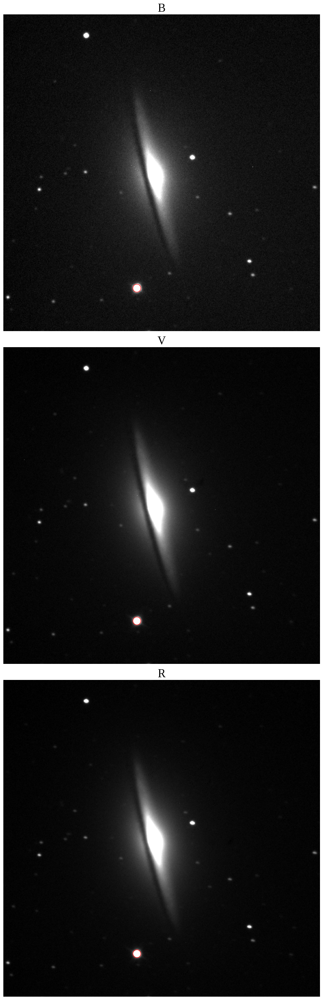

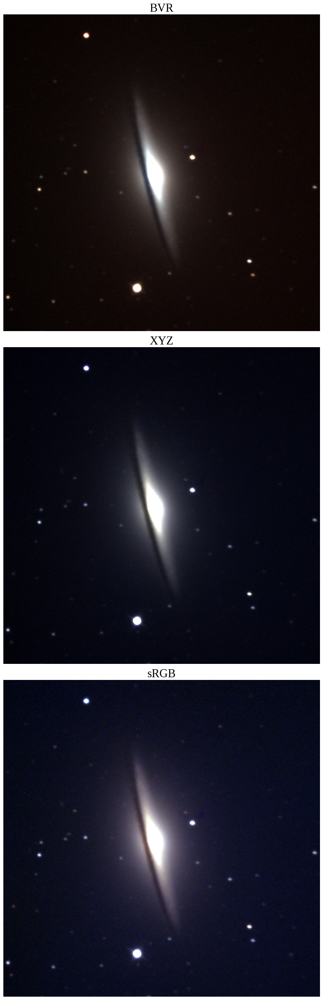

In [9]:
colour_images('Sombrero', stacked_images_sombrero, a=800, b=800, shift_x=0, shift_y=50, x_min_bkg=0, y_min_bkg=100, width_bkg=100, height_bkg=100, radius_ws=10, threshold=5)


Closest star with B-V index -0.04


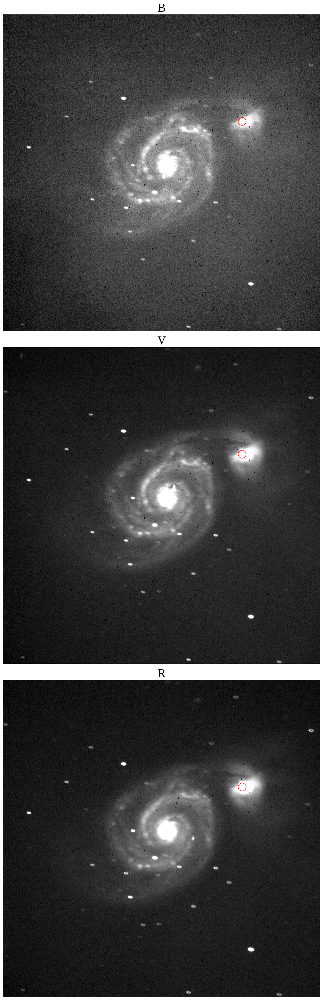

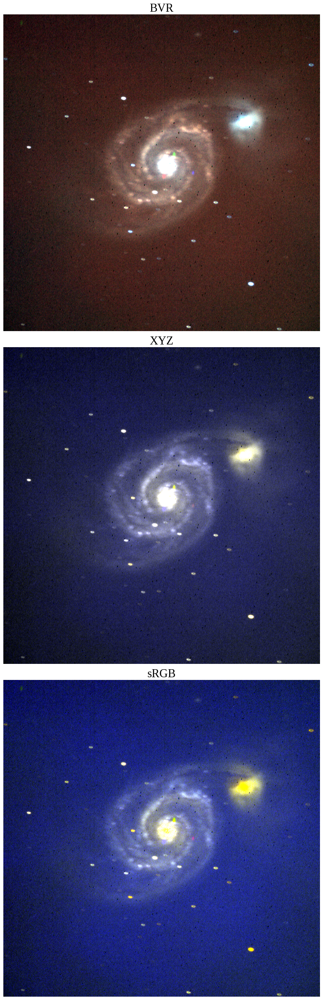

In [10]:
colour_images('M51', stacked_images_m51, a=1200, b=1200, shift_x=0, shift_y=50, x_min_bkg=0, y_min_bkg=800, width_bkg=200, height_bkg=200, radius_ws=15, threshold=5)

Closest star with B-V index -0.02


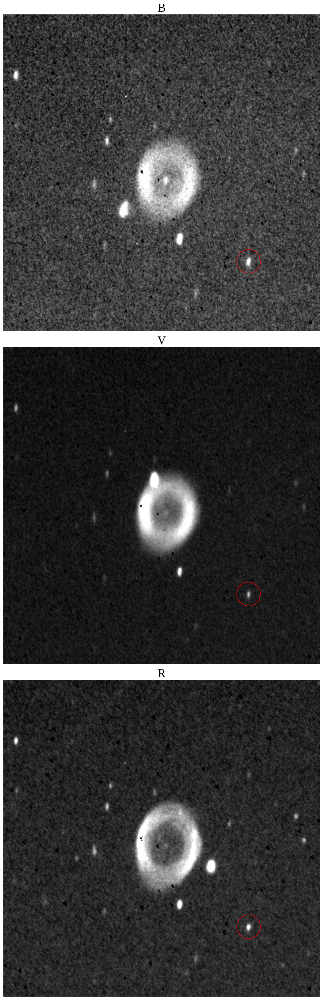

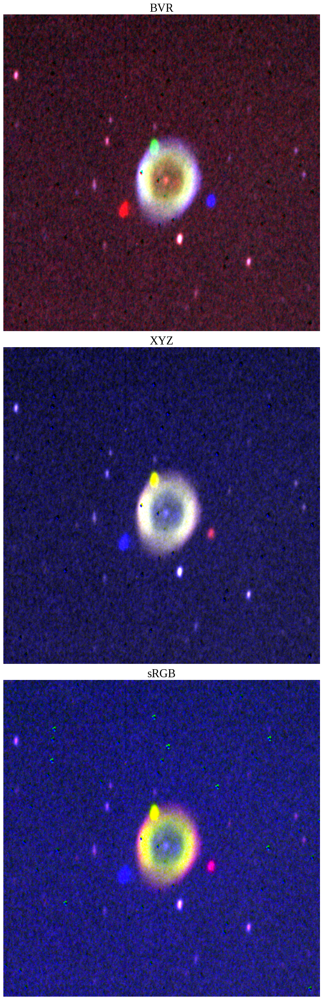

In [11]:
colour_images('M57', stacked_images_m57, a=400, b=400, shift_x=-55, shift_y=15, x_min_bkg=0, y_min_bkg=100, width_bkg=100, height_bkg=100, radius_ws=15, threshold=5)

Closest star with B-V index -0.01


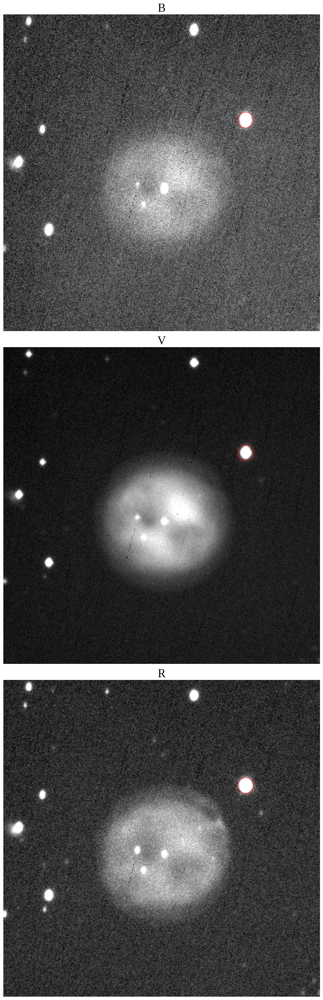

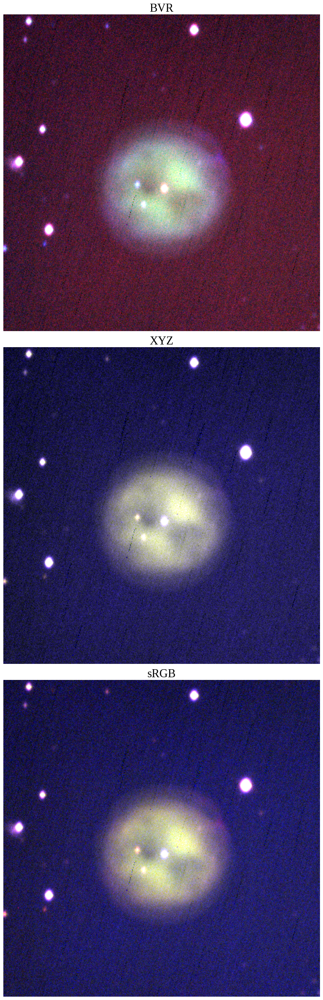

In [12]:
colour_images('M97', stacked_images_m97, a=600, b=600, shift_x=0, shift_y=0, x_min_bkg=0, y_min_bkg=200, width_bkg=200, height_bkg=200, radius_ws=15, threshold=5)